# Articulation Synthesis for Stringed Instruments
#### By: Shresta Bangaru

### **Part 2: Melody generation with specific articulation sound files**

Constants/helper methods from Part 1

In [1]:
all_notes = [
    "StringENoteA", # 0 
    "StringENoteG", # 1
    "StringENoteFSharp", # 2
    "StringENoteE", # 3
    "StringANoteD", # 4
    "StringANoteCSharp", # 5
    "StringANoteB", # 6
    "StringANoteA", # 7
    "StringDNoteG", # 8
    "StringDNoteFSharp", # 9
    "StringDNoteE", # 10
    "StringDNoteD", # 11
    "StringGNoteCSharp", # 12
    "StringGNoteB", # 13
    "StringGNoteA", # 14
    # "StringGNoteG.m4a", # 15 # TODO: uncomment this 
]

In [4]:
# !pip install pydub

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [5]:
from pydub import AudioSegment

def extract_segment(filename, out_filename, start_time, duration, file_type): # milliseconds
  # Load the audio file into a Pydub AudioSegment object
  audio = AudioSegment.from_file(filename, format = file_type)

  if start_time + duration > len(audio):
    duration = len(audio) - start_time
    print("Warning: Duration exceeds the file length. Snipping up to the end of the file.")

  # Extract the specified segment from the audio
  segment = audio[start_time:start_time + duration]

  # Save the extracted segment as a new audio file
  segment.export(out_filename, format = file_type)

### Step 1: Download all relevant sound files. 

In [6]:
for note in all_notes: 
  dir = "https://github.com/shresta4/CS448-files/raw/main/Final_Proj/" 

  normal_path = dir + "trim/" + note + ".wav" 
  !wget $normal_path

  vibrato_path = dir + "vibrato/" + note + "_vibrato.wav"
  !wget $vibrato_path

  staccato_path = dir + "staccato/" + note + "_staccato.wav"
  !wget $staccato_path

  legato_path = dir + "legato/" + note + "_legato.wav"
  !wget $legato_path

  accented_path = dir + "accented/" + note + "_accented.wav"
  !wget $accented_path

--2023-05-07 15:38:39--  https://github.com/shresta4/CS448-files/raw/main/Final_Proj/trim/StringENoteA.wav
Resolving github.com (github.com)... 20.27.177.113
Connecting to github.com (github.com)|20.27.177.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/shresta4/CS448-files/main/Final_Proj/trim/StringENoteA.wav [following]
--2023-05-07 15:38:40--  https://raw.githubusercontent.com/shresta4/CS448-files/main/Final_Proj/trim/StringENoteA.wav
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.111.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 192044 (188K) [audio/wav]
Saving to: ‘StringENoteA.wav’

StringENoteA.wav    100%[===================>] 187.54K  --.-KB/s    in 0.04s   

2023-05-07 15:38:40 (4.89 MB/s) - ‘StringENoteA.wav’ saved [192044/192

### Step 2: Create a function that will accept inputs of notes (with length and articulation) and generate a tune. 

In [7]:
notes_dir = "temp4" # Change this to whatever directory you want all your notes stored in 

Now, create a directory with the above label, in /content/. Please make sure it is a unique label. 

In [8]:
import os

def concat_sounds(dir, title, count): 
  combined_audio = AudioSegment.silent(duration = 0)

  for i in range(count): 
    filename = "file_" + str(i)
    audio = AudioSegment.from_wav(os.path.join(dir, filename))
    combined_audio += audio

  combined_audio.export(title + ".wav", format="wav")

In [9]:
def create_tune(notes, title): 
  idx = 0
  for note in notes: 
    extract_segment(note[0] + note[2] + ".wav", "/content/" + notes_dir + "/file_" + str(idx), 0, 1000 * note[1], file_type = "wav")
    idx += 1

  concat_sounds("/content/" + notes_dir, title, idx)

Specification: notes is an array of tuples of this format: [(note_name, duration, articulation), etc.]. Articulation is specified with an underscore "_" and the lowercase word, like _legato. 

### Step 4: Use previous function to synthesize Ode to Joy (Beethoven) with and without articulations specified. 

Sheet music (Treble clef): https://makingmusicfun.net/public/assets/pdf/sheet_music/ode_to_joy_violin.pdf

First without any articulation specified. Using "" to indicate that a note is normal. 

In [10]:
factor = 2

ode_to_joy_notes_normal = [
    ("StringDNoteFSharp", 0.25 * factor, ""), # 0.25 means quarter note
    ("StringDNoteFSharp", 0.25 * factor, ""), 
    ("StringDNoteG", 0.25 * factor, ""), 
    ("StringANoteA", 0.25 * factor, ""), 
    ("StringANoteA", 0.25 * factor, ""), 
    ("StringDNoteG", 0.25 * factor, ""), 
    ("StringDNoteFSharp", 0.25 * factor, ""), 
    ("StringDNoteE", 0.25 * factor, ""), 
    ("StringDNoteD", 0.25 * factor, ""), 
    ("StringDNoteD", 0.25 * factor, ""), 
    ("StringDNoteE", 0.25 * factor, ""), 
    ("StringDNoteFSharp", 0.25 * factor, ""), 
    ("StringDNoteFSharp", 0.375 * factor, ""), # 0.375 is dotted eighth note
    ("StringDNoteE", 0.125 * factor, ""), # 0.125 is eighth note 
    ("StringDNoteE", 0.5 * factor, "") # 0.5 is half note 
]

See this reference https://www.skoove.com/blog/eighth-and-sixteenth-notes/ to understand eighth and dotted eighth notes, for those who are not familiar with reading sheet music. 

In [11]:
create_tune(ode_to_joy_notes_normal, "Ode to Joy (no articulation specified)")

Now with articulation. Set notes_dir again to a unique directory location. 

In [12]:
notes_dir = "temp6" # Change this to whatever directory you want all your notes stored in 

In [13]:
factor = 5

ode_to_joy_notes_articulated = [
    ("StringDNoteFSharp", 0.25 * factor, "_vibrato"), # 0.25 means quarter note
    ("StringDNoteFSharp", 0.25 * factor, "_vibrato"), 
    ("StringDNoteG", 0.25 * factor, ""), 
    ("StringANoteA", 0.25 * factor, ""), 
    ("StringANoteA", 0.25 * factor, ""), 
    ("StringDNoteG", 0.25 * factor, ""), 
    ("StringDNoteFSharp", 0.25 * factor, ""), 
    ("StringDNoteE", 0.25 * factor, ""), 
    ("StringDNoteD", 0.25 * factor, ""), 
    ("StringDNoteD", 0.25 * factor, ""), 
    ("StringDNoteE", 0.25 * factor, ""), 
    ("StringDNoteFSharp", 0.25 * factor, ""), 
    ("StringDNoteFSharp", 0.375 * factor, "_vibrato"), # 0.375 is dotted eighth note
    ("StringDNoteE", 0.125 * factor, ""), # 0.125 is eighth note 
    ("StringDNoteE", 0.5 * factor, "_vibrato") # 0.5 is half note 
]

In [14]:
create_tune(ode_to_joy_notes_articulated, "Ode to Joy (articulated)")

Visualize audio files. 

In [15]:
import matplotlib.pyplot as plt
from scipy.io import wavfile

def compare_audio_files(file1, file2):
    # Read the audio files
    rate1, data1 = wavfile.read(file1)
    rate2, data2 = wavfile.read(file2)

    # Ensure that both files have the same sample rate
    assert rate1 == rate2, "Sample rates of the audio files don't match."

    # Trim the longer signal to the length of the shorter one
    min_len = min(len(data1), len(data2))
    data1 = data1[:min_len]
    data2 = data2[:min_len]

    # Compute the mean squared error (MSE)
    mse = np.mean((data1 - data2) ** 2)

    # Visualize the audio signals
    time = np.arange(len(data1)) / rate1

    plt.figure(figsize=(12, 6))
    plt.subplot(2, 1, 1)
    plt.plot(time, data1, 'b', label='Original')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title('Original Audio')
    plt.legend()

    plt.subplot(2, 1, 2)
    plt.plot(time, data2, 'r', label='Modified')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title('Modified Audio')
    plt.legend()

    plt.tight_layout()
    plt.show()

In [23]:
import numpy as np
from scipy.signal import spectrogram

In [24]:
def plot_spectrogram(file_path, title):
    # Read the audio file
    sample_rate, samples = wavfile.read(file_path)

    # Compute the spectrogram
    frequencies, times, spectrogram_data = spectrogram(samples, sample_rate)

    # Plot the spectrogram
    plt.figure(figsize=(10, 6))
    plt.imshow(np.log(spectrogram_data), aspect='auto', cmap='jet', origin='lower')
    plt.colorbar(format='%+2.0f dB')
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    plt.title(title + 'Spectrogram')
    plt.show()

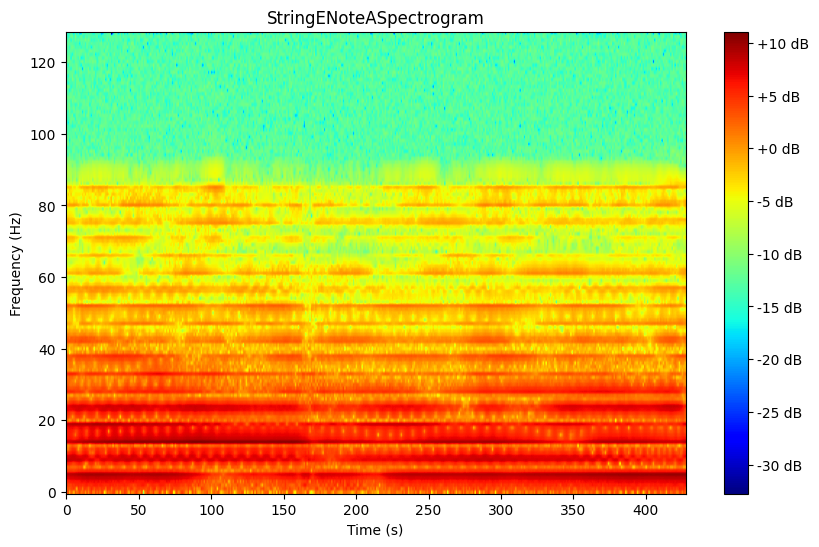

<ipython-input-24-0d523059c76f>:10: RuntimeWarning: divide by zero encountered in log
  plt.imshow(np.log(spectrogram_data), aspect='auto', cmap='jet', origin='lower')


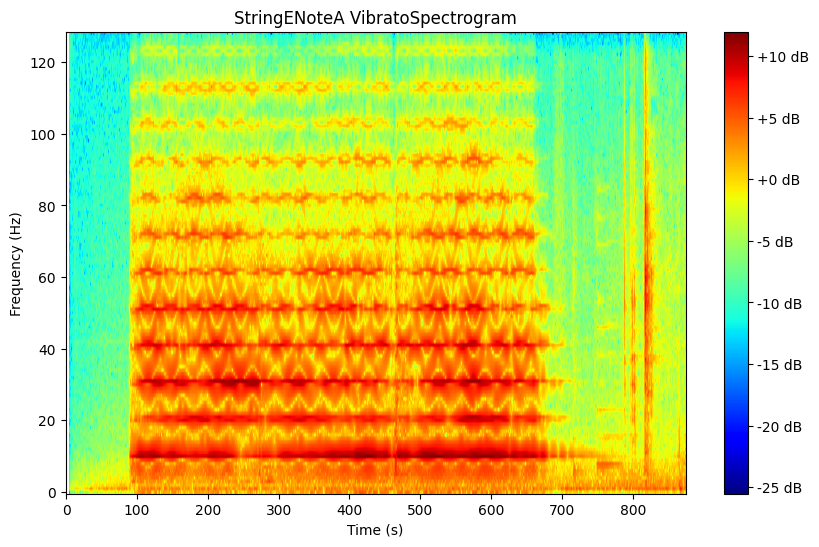

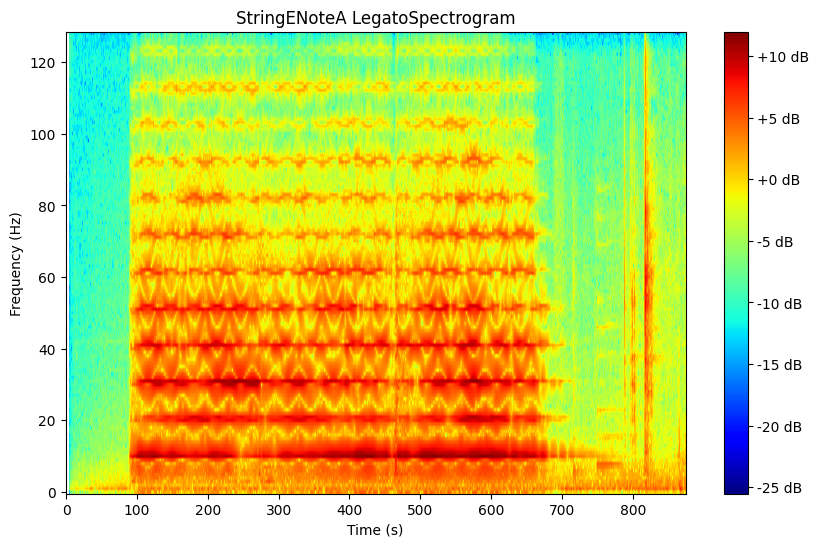

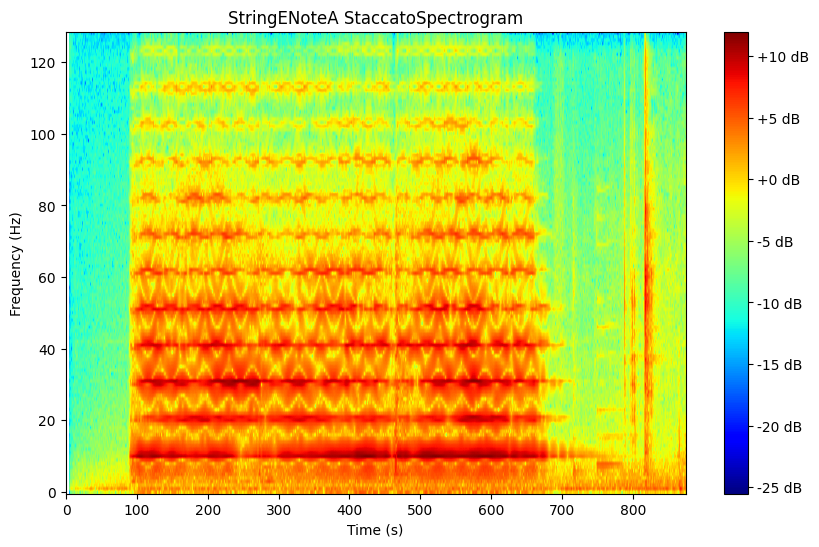

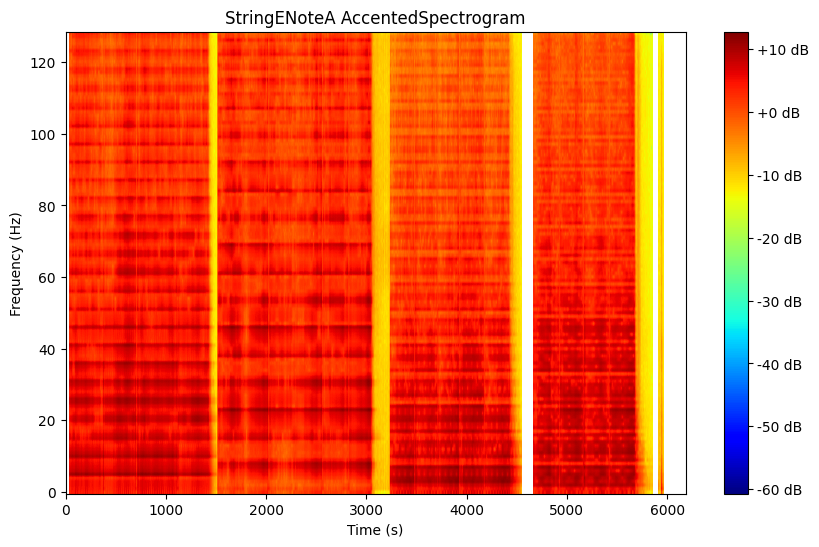

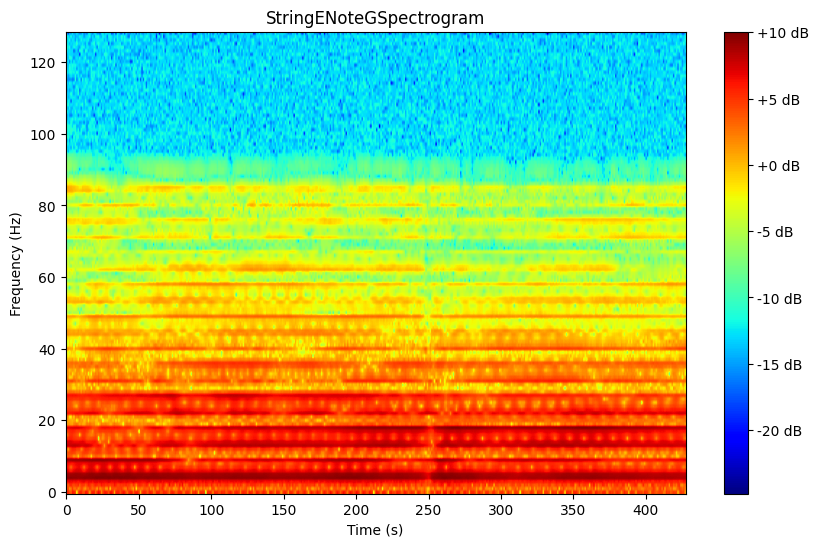

...

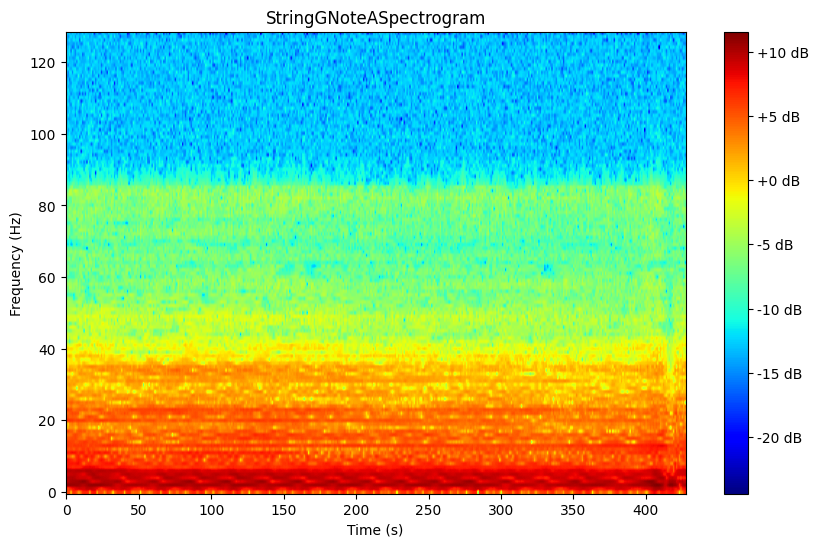

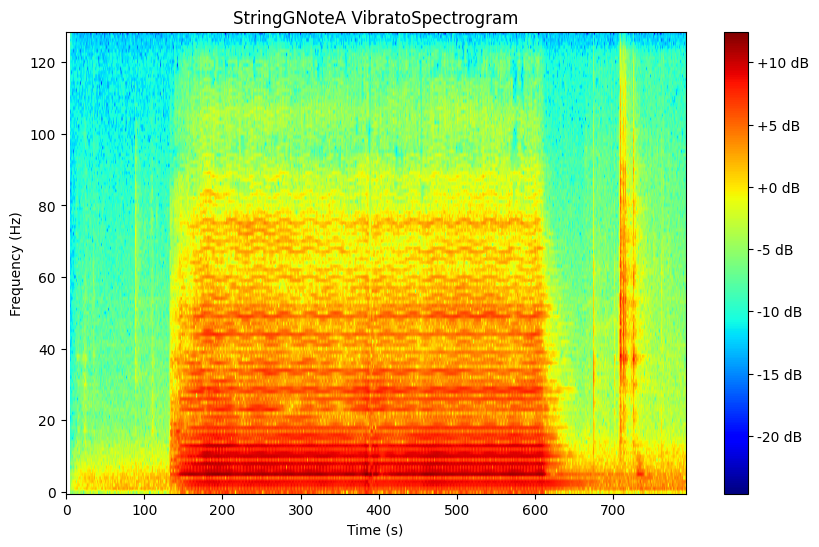

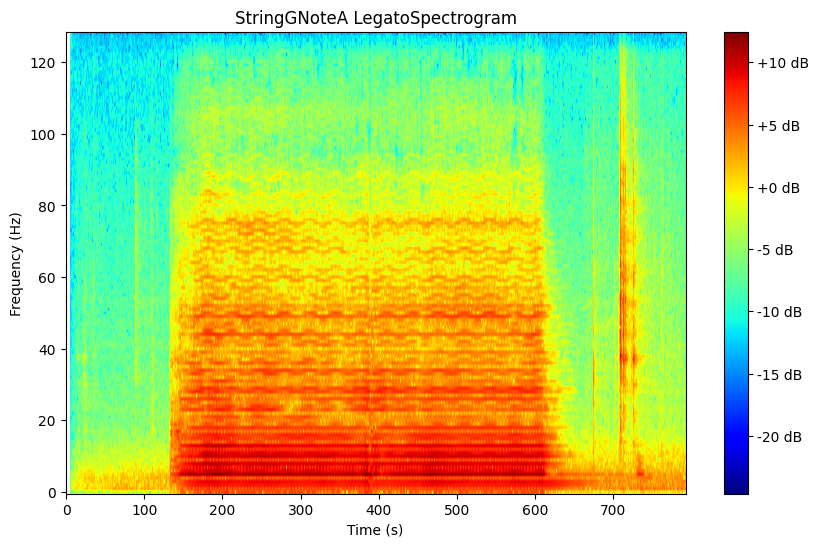

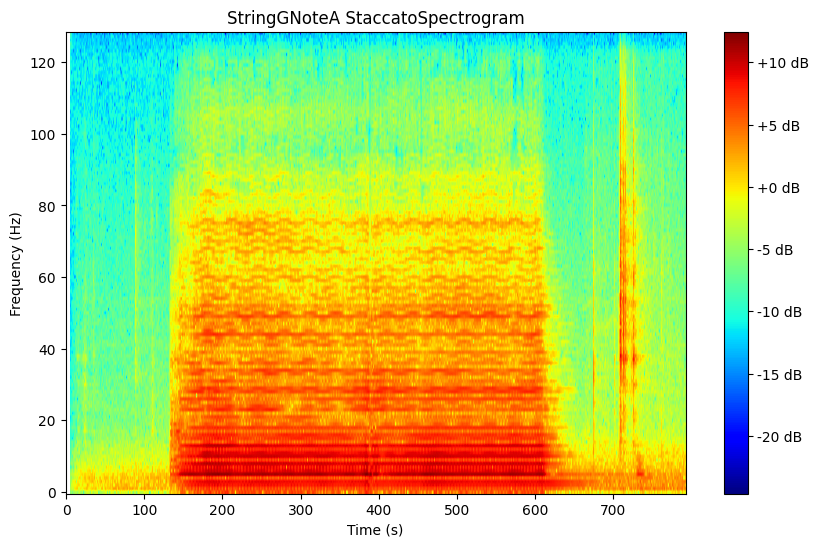

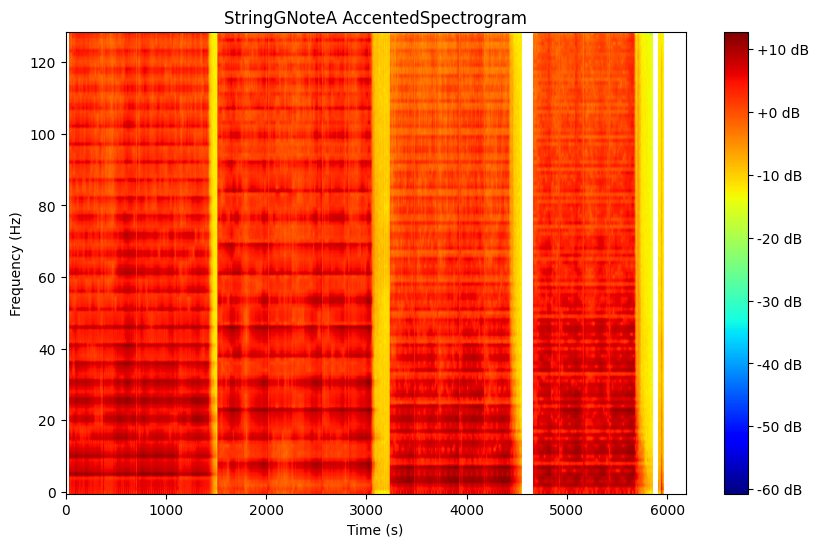

In [27]:
for note in all_notes: 
  try: 
    plot_spectrogram(note + ".wav", note)
    plot_spectrogram(note + "_vibrato" + ".wav", note + " Vibrato")
    plot_spectrogram(note + "_legato" + ".wav", note + " Legato")
    plot_spectrogram(note + "_staccato" + ".wav", note + " Staccato")
    plot_spectrogram(note + "_accented" + ".wav", note + " Accented")
  except:
    continue